<a href="https://colab.research.google.com/github/AdiGiriIIT/AdiGiriIIT/blob/main/Basics_of_image_processing_04_02_26_with_exercises.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Image Filtering: Spatial vs Frequency Domain — Hands-on Notebook

This notebook contains theory and runnable code examples for:
- Noise models (Gaussian, Salt & Pepper)
- Spatial-domain filters: median, Gaussian (manual + OpenCV), bilateral
- Frequency-domain filtering using FFT (Gaussian LPF/HPF)

Run the cells in order. Change parameters in the **Try-it** cells to explore.

In [1]:
# Basic imports
import numpy as np
import matplotlib.pyplot as plt
import cv2
from scipy.ndimage import convolve
from scipy.signal import medfilt2d
import os

from numpy.fft import fft2, ifft2, fftshift
import cv2
import time


In [2]:
# Helper functions: load image, noise addition, metrics, kernels

def load_gray_image(path=None):
    """Load a grayscale image normalized to [0,1]"""

    im = cv2.imread(path, cv2.IMREAD_GRAYSCALE)
    print(im.shape)
    return im.astype(np.float32)/255.0

def add_gaussian_noise(image, mean=0.0, var=0.2):
    sigma = np.sqrt(var)
    gauss = np.random.normal(mean, sigma, image.shape).astype(np.float32)
    noisy = image + gauss
    return np.clip(noisy, 0.0, 1.0)

def add_salt_pepper_noise(image, salt_prob=0.01, pepper_prob=0.01):
    noisy = image.copy()
    # Salt
    num_salt = np.ceil(salt_prob * image.size).astype(int)
    coords = (np.random.randint(0, i, num_salt) for i in image.shape)
    noisy[tuple(coords)] = 1.0
    # Pepper
    num_pepper = np.ceil(pepper_prob * image.size).astype(int)
    coords = (np.random.randint(0, i, num_pepper) for i in image.shape)
    noisy[tuple(coords)] = 0.0
    return noisy

def gaussian_kernel(size, sigma=1.0):
    ax = np.arange(-size//2 + 1., size//2 + 1.)
    xx, yy = np.meshgrid(ax, ax)
    kernel = np.exp(-(xx**2 + yy**2) / (2. * sigma**2))
    kernel = kernel / np.sum(kernel)
    return kernel


## 1) Noise models

We will demonstrate two common noise models:

- **Gaussian noise**: additive zero-mean Gaussian with variance $\sigma^2$.
- **Salt & Pepper noise**: random pixels set to 0 (pepper) or 1 (salt).

Change the variance and observe how filtering performance changes.

(256, 256)


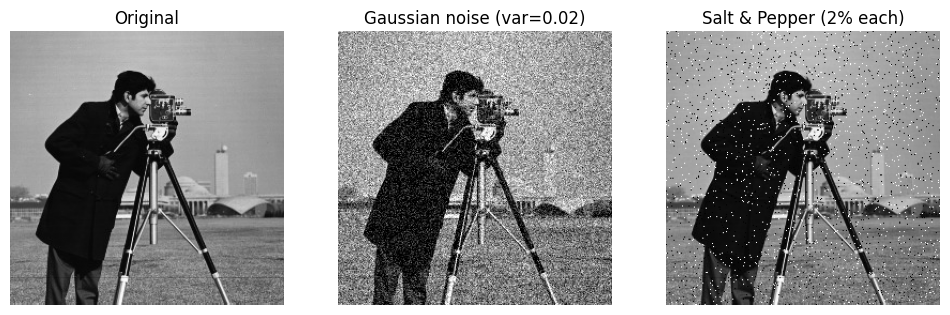

In [3]:
# Load image and show noisy versions
img = load_gray_image("cameraman.jpeg")
np.random.seed(0)

img_gauss = add_gaussian_noise(img, var=0.02)
img_sp = add_salt_pepper_noise(img, salt_prob=0.02, pepper_prob=0.02)

plt.figure(figsize=(12,4))
plt.subplot(1,3,1); plt.imshow(img, cmap='gray'); plt.title('Original'); plt.axis('off')
plt.subplot(1,3,2); plt.imshow(img_gauss, cmap='gray'); plt.title('Gaussian noise (var=0.02)'); plt.axis('off')
plt.subplot(1,3,3); plt.imshow(img_sp, cmap='gray'); plt.title('Salt & Pepper (2% each)'); plt.axis('off')
plt.show()

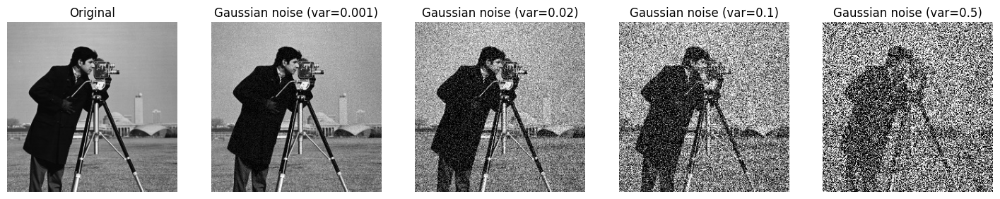

In [4]:
img_gauss_smallest = add_gaussian_noise(img, var=0.001)
img_gauss_small = add_gaussian_noise(img, var = 0.02)
img_gauss_med = add_gaussian_noise(img, var = 0.1)
img_gauss_large = add_gaussian_noise(img, var = 0.5)

plt.figure(figsize=(18, 12))
plt.subplot(1,5,1); plt.imshow(img, cmap='gray'); plt.title('Original'); plt.axis('off')
plt.subplot(1,5,2); plt.imshow(img_gauss_smallest, cmap='gray'); plt.title('Gaussian noise (var=0.001)'); plt.axis('off')
plt.subplot(1,5,3); plt.imshow(img_gauss_small, cmap='gray'); plt.title('Gaussian noise (var=0.02)'); plt.axis('off')
plt.subplot(1,5,4); plt.imshow(img_gauss_med, cmap='gray'); plt.title('Gaussian noise (var=0.1)'); plt.axis('off')
plt.subplot(1,5,5); plt.imshow(img_gauss_large, cmap='gray'); plt.title('Gaussian noise (var=0.5)'); plt.axis('off')
plt.show()

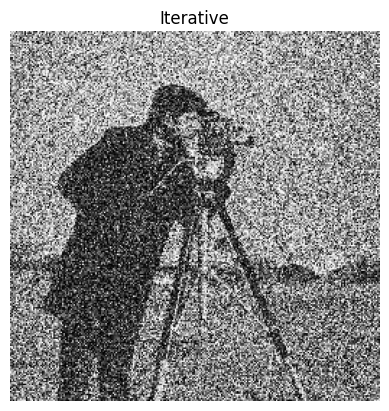

In [5]:
n = 100
img_gauss_n = np.copy(img)
for i in range(n):
    img_gauss_n = add_gaussian_noise(img_gauss_n, var = 0.001)
plt.imshow(img_gauss_n, cmap = 'gray'); plt.title('Iterative'); plt.axis('off')
plt.show()

## 2) Spatial-domain filters

**Box Filter**: Kernel has all values as the same

**Gaussian filter** (linear): convolution with a Gaussian kernel; good for smoothing Gaussian noise. Kernel equation:

$$
G(x,y) = \frac{1}{2\pi\sigma^2} e^{-\frac{x^2+y^2}{2\sigma^2}}
$$

**Bilateral filter**: edge-preserving filter that weights both spatial distance and intensity difference.

### Bilateral Filter

The bilateral filter computes the output intensity at a pixel $p$ as:

$$
I_{out}(p) = \frac{1}{W_p} \sum_{q \in \Omega} I(q) \;
\exp\left(-\frac{\|p-q\|^2}{2\sigma_s^2}\right) \;
\exp\left(-\frac{(I(p)-I(q))^2}{2\sigma_r^2}\right)
$$

where:

- $I(p)$ : intensity at pixel $p$  
- $\Omega$ : neighborhood around $p$  
- $\sigma_s$ : spatial smoothing parameter (`sigmaSpace`)  
- $\sigma_r$ : range smoothing parameter (`sigmaColor`)  
- $W_p$ : normalization term, given by  

$$
W_p = \sum_{q \in \Omega}
\exp\left(-\frac{\|p-q\|^2}{2\sigma_s^2}\right) \;
\exp\left(-\frac{(I(p)-I(q))^2}{2\sigma_r^2}\right)
$$


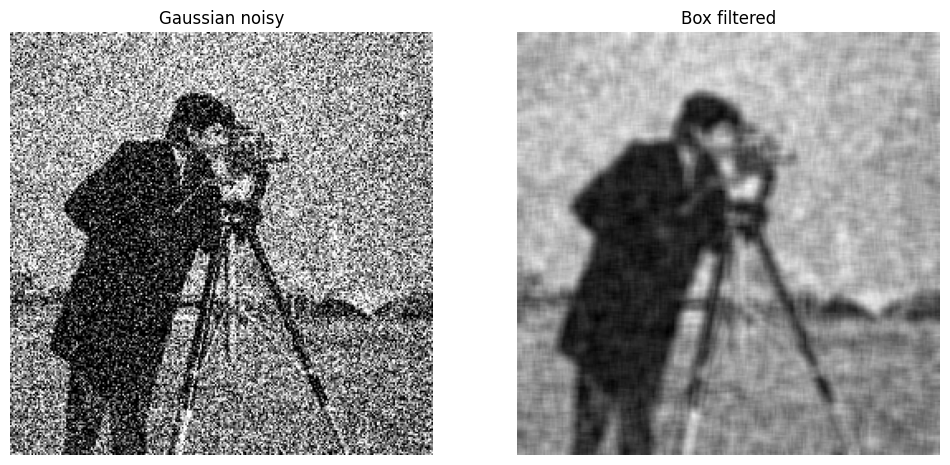

In [6]:
# Box Filter
N = 7
kern = np.ones((N, N)) / (N*N)
box_from_manual = convolve(img_gauss_med, kern, mode='reflect')

# Show
plt.figure(figsize=(12,6))
plt.subplot(1,2,1); plt.imshow(img_gauss_med, cmap='gray'); plt.title('Gaussian noisy'); plt.axis('off')
plt.subplot(1,2,2); plt.imshow(box_from_manual, cmap='gray'); plt.title('Box filtered'); plt.axis('off')
plt.show()

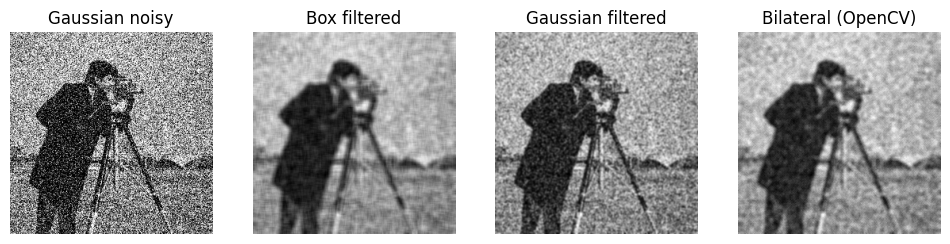

In [7]:
# Gaussian filter manual (convolution)
kern = gaussian_kernel(7, sigma=1)
gauss_from_manual = convolve(img_gauss_med, kern, mode='reflect')
# Bilateral filter (OpenCV) on u8
bilat = cv2.bilateralFilter(img_gauss_med, d=7, sigmaColor=75, sigmaSpace=75).astype(np.float32)/255.0

# Show
plt.figure(figsize=(12,6))
plt.subplot(1,4,1); plt.imshow(img_gauss_med, cmap='gray'); plt.title('Gaussian noisy'); plt.axis('off')
plt.subplot(1,4,2); plt.imshow(box_from_manual, cmap='gray'); plt.title('Box filtered'); plt.axis('off')
plt.subplot(1,4,3); plt.imshow(gauss_from_manual, cmap='gray'); plt.title('Gaussian filtered'); plt.axis('off')
plt.subplot(1,4,4); plt.imshow(bilat, cmap='gray'); plt.title('Bilateral (OpenCV)'); plt.axis('off')
plt.show()

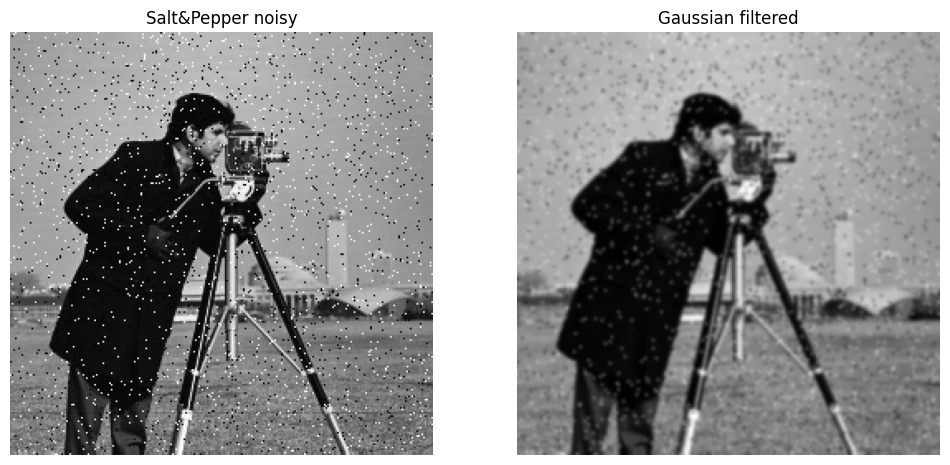

In [8]:
gauss_sp = convolve(img_sp, kern, mode='reflect')

plt.figure(figsize=(12,6))
plt.subplot(1,2,1); plt.imshow(img_sp, cmap='gray'); plt.title('Salt&Pepper noisy'); plt.axis('off')
plt.subplot(1,2,2); plt.imshow(gauss_sp, cmap='gray'); plt.title('Gaussian filtered'); plt.axis('off')
plt.show()

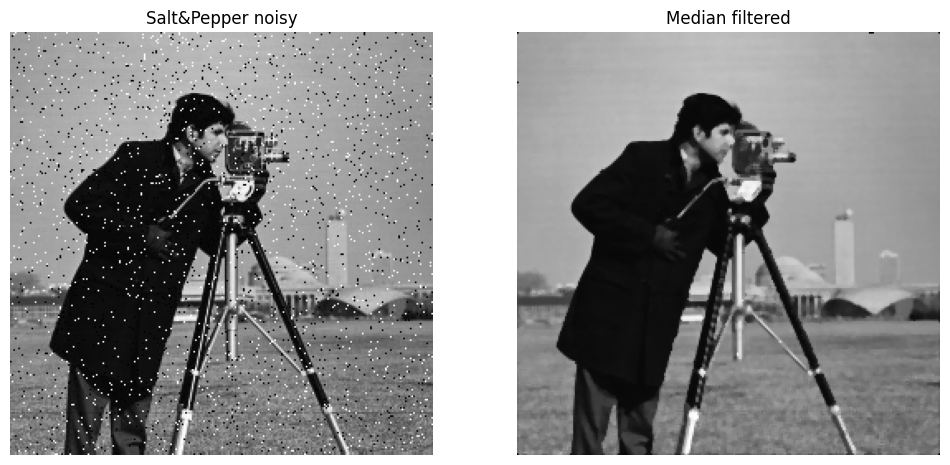

In [9]:
med_sp = medfilt2d(img_sp, kernel_size=3)

plt.figure(figsize=(12,6))
plt.subplot(1,2,1); plt.imshow(img_sp, cmap='gray'); plt.title('Salt&Pepper noisy'); plt.axis('off')
plt.subplot(1,2,2); plt.imshow(med_sp, cmap='gray'); plt.title('Median filtered'); plt.axis('off')
plt.show()

Manual Median Filter Time: 1.9102 s
SciPy medfilt2d Time: 0.0095 s
Max Pixel Difference: 0.615686297416687


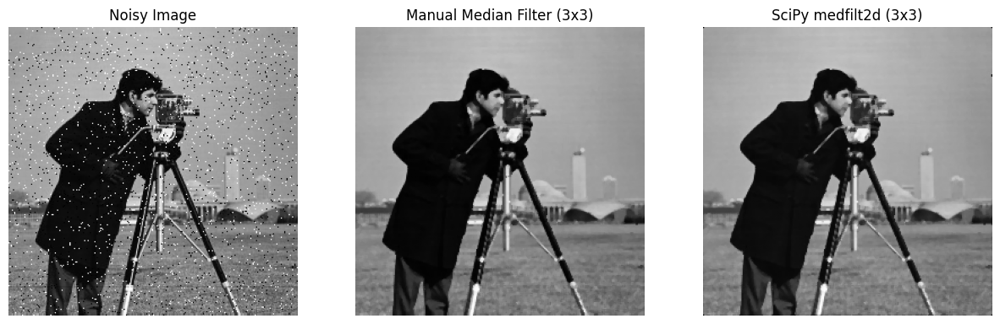

In [10]:

noisy_img = add_salt_pepper_noise(img, salt_prob=0.02, pepper_prob=0.02)
# -------------------- Manual Median Filter --------------------
def manual_median_filter(image, kernel_size=3):
    pad = kernel_size // 2
    padded = np.pad(image, pad, mode='edge')
    output = np.zeros_like(image)

    H, W = image.shape
    for i in range(H):
        for j in range(W):
            window = padded[i:i+kernel_size, j:j+kernel_size]
            output[i, j] = np.median(window)
    return output

# -------------------- Compare Speed --------------------
ksize = 3

# Manual filter
t1 = time.time()
manual_filtered = manual_median_filter(noisy_img, kernel_size=ksize)
t2 = time.time()

# Built-in medfilt2d
t3 = time.time()
scipy_filtered = medfilt2d(noisy_img, kernel_size=ksize)
t4 = time.time()

print(f"Manual Median Filter Time: {(t2 - t1):.4f} s")
print(f"SciPy medfilt2d Time: {(t4 - t3):.4f} s")
print(f"Max Pixel Difference: {np.abs(manual_filtered - scipy_filtered).max()}")

# -------------------- Plot Results --------------------
fig, axs = plt.subplots(1, 3, figsize=(15, 5))

axs[0].imshow(noisy_img, cmap='gray')
axs[0].set_title("Noisy Image")
axs[0].axis("off")

axs[1].imshow(manual_filtered, cmap='gray')
axs[1].set_title(f"Manual Median Filter ({ksize}x{ksize})")
axs[1].axis("off")

axs[2].imshow(scipy_filtered, cmap='gray')
axs[2].set_title(f"SciPy medfilt2d ({ksize}x{ksize})")
axs[2].axis("off")

plt.show()


## 3) Frequency-domain filtering (FFT)

Fourier transform (2D discrete):

$$
F(u,v) = \sum_{x=0}^{M-1} \sum_{y=0}^{N-1} f(x,y) e^{-j 2\pi (ux/M + vy/N)}
$$

We will build Gaussian low-pass and high-pass filters in the frequency domain. Steps:
1. Compute FFT of image
2. Shift zero-frequency to center (fftshift)
3. Multiply spectrum by filter mask
4. Inverse shift and inverse FFT



In [11]:
# Function to compute FFT and return fshift + magnitude spectrum
def compute_fft(img):
    f = np.fft.fft2(img)
    fshift = np.fft.fftshift(f)
    magnitude_spectrum = np.log(np.abs(fshift) + 1)
    return fshift, magnitude_spectrum

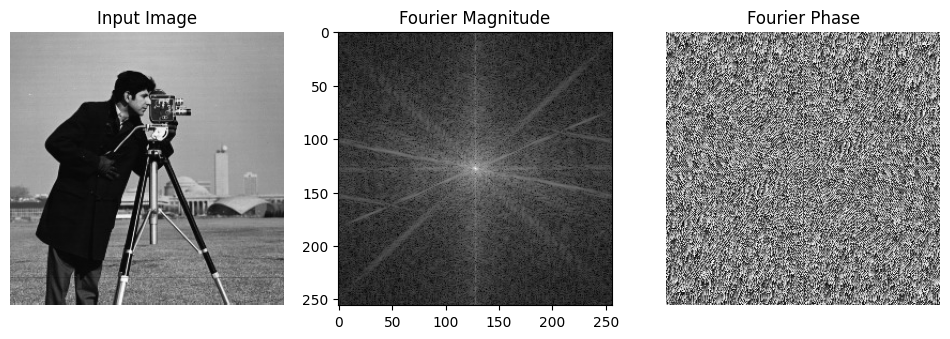

In [12]:
def plot_fourier(img):
    fshift_img, mag_img = compute_fft(img)
    phase = np.angle(fshift_img)
    plt.figure(figsize=(12, 6))
    plt.subplot(1,3,1)
    plt.imshow(img, cmap='gray', vmin = 0, vmax = 1)
    plt.title("Input Image")
    plt.axis('off')

    plt.subplot(1,3,2)
    plt.imshow(mag_img, cmap = 'gray')
    plt.title("Fourier Magnitude")
    plt.axis('on')

    plt.subplot(1,3,3)
    plt.imshow(phase, cmap="gray")
    plt.title("Fourier Phase")
    plt.axis('off')


plot_fourier(img)

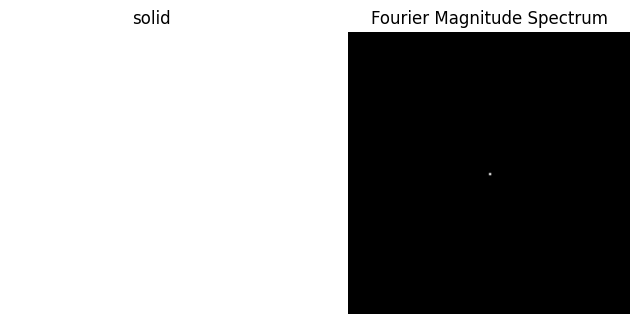

In [93]:
def save_and_plot_fft(img, img_name="image", spectrum_name="spectrum"):
    f = np.fft.fft2(img)
    fshift = np.fft.fftshift(f)
    magnitude_spectrum = np.log1p(np.abs(fshift))  # log scaling

    plt.imsave(f"{img_name}.png", img, cmap="gray", vmin=0, vmax=1)

    plt.imsave(f"{spectrum_name}.png", magnitude_spectrum, cmap="gray")

    plt.figure(figsize=(8,4))

    plt.subplot(1,2,1)
    plt.imshow(img, cmap="gray", vmin=0, vmax=1)
    plt.title(str(img_name))
    plt.axis("off")

    plt.subplot(1,2,2)
    plt.imshow(magnitude_spectrum, cmap="gray")
    plt.title("Fourier Magnitude Spectrum")
    plt.axis("off")

    plt.show()

solid_image = np.ones(shape = (128, 128))
save_and_plot_fft(solid_image, "solid", "solid_spectrum")

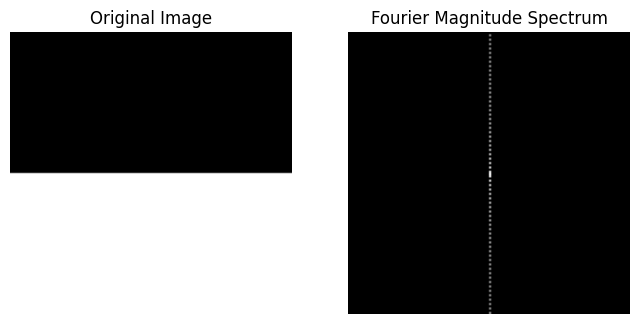

In [14]:
def step_edge_x(height=128, width=128):
    img = np.zeros((height, width))
    img[:, width//2:] = 1   # right half white
    return img

def step_edge_y(height=128, width=128):
    img = np.zeros((height, width))
    img[height//2:, :] = 1  # bottom half white
    return img

img_x = step_edge_x()
img_y = step_edge_y()
save_and_plot_fft(img_y, "stepy", "stepy_spectrum")

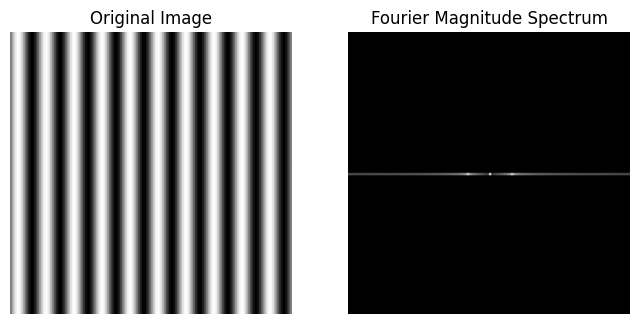

In [15]:
def sinusoidal_images(size=128, freq=5):
    x = np.linspace(0, 2*np.pi, size)
    y = np.linspace(0, 2*np.pi, size)
    xx, yy = np.meshgrid(x, y)

    # Sinusoid varying in x-direction (vertical stripes)
    x_sin = 0.5 * (1 + np.sin(freq * xx))  # normalize to [0,1]

    # Sinusoid varying in y-direction (horizontal stripes)
    y_sin = 0.5 * (1 + np.sin(freq * yy))  # normalize to [0,1]

    return x_sin, y_sin

# Example usage
xsin_img, ysin_img = sinusoidal_images(size=128, freq=10)
save_and_plot_fft(xsin_img, "sinx", "sinx_spectrum")

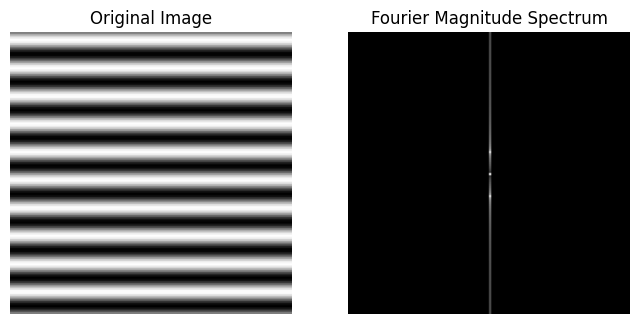

In [16]:
save_and_plot_fft(ysin_img, "siny", "siny_spectrum")

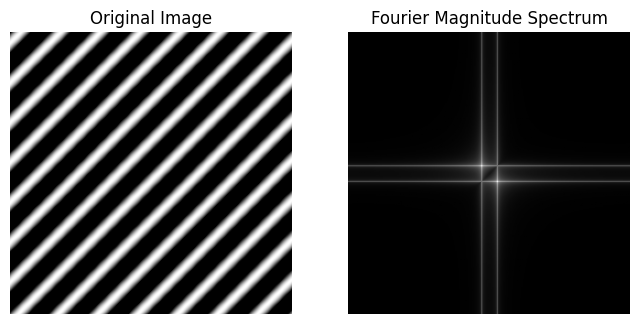

In [17]:
def generate_45deg_sinusoid(size=256, frequency=10):
    x = np.arange(size)
    y = np.arange(size)
    X, Y = np.meshgrid(x, y)

    coord = (X + Y) / np.sqrt(2)

    sinusoid = np.sin(2 * np.pi * frequency * coord / size)

    return sinusoid

# Example usage
sin45_img = generate_45deg_sinusoid(size=256, frequency=10)
save_and_plot_fft(sin45_img, "sin45", "sin45_spectrum")


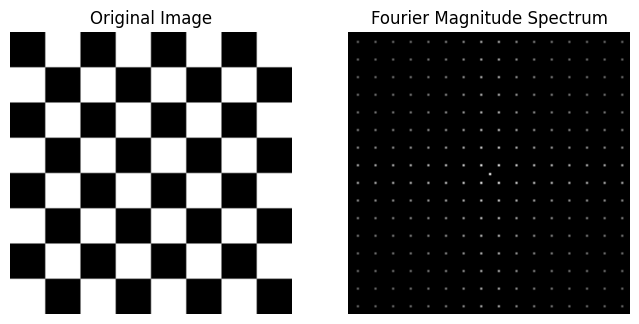

In [18]:

def generate_chessboard(size=256, num_squares=8):
    # Pixel grid
    x = np.arange(size)
    y = np.arange(size)
    X, Y = np.meshgrid(x, y)

    # Size of each square
    square_size = size // num_squares

    # Alternating pattern using integer division
    board = ((X // square_size) + (Y // square_size)) % 2

    return board

# Example usage
chessboard_img = generate_chessboard(size=128, num_squares=8)
save_and_plot_fft(chessboard_img, "chessboard", "chessboard_spectrum")

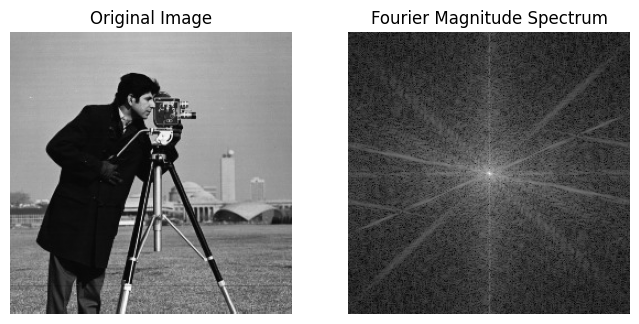

In [19]:
save_and_plot_fft(img, "cameraman", "cameraman_spectrum")

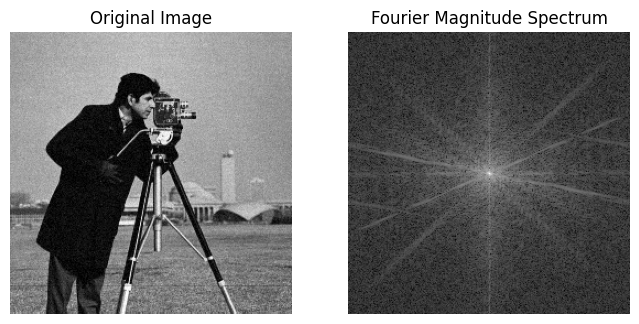

In [20]:
save_and_plot_fft(img_gauss_smallest, "camgauss", "camgauss_spectrum")

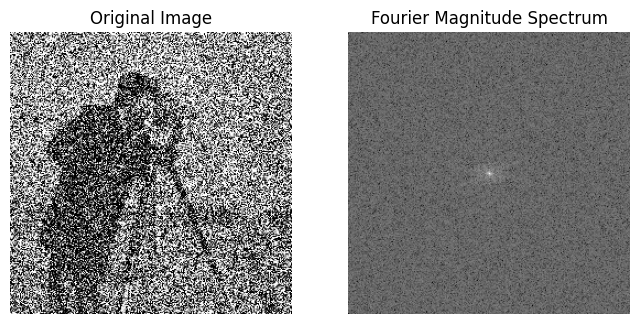

In [21]:
save_and_plot_fft(img_gauss_large, "camgauss", "camgauss_spectrum")

In [22]:
pad_kern = np.zeros_like(img, dtype=np.float32)
kern = gaussian_kernel(5, sigma=1)
kh, kw = kern.shape
r, c = img.shape

# # Compute starting indices for centering
start_x = (r - kh) // 2
start_y = (c - kw) // 2
plt.imsave("gauss_small.png", kern, cmap="gray")
pad_kern[start_x:start_x+kh, start_y:start_y+kw] = kern
# save_and_plot_fft(pad_kern, "gauss", "gauss_spectrum")

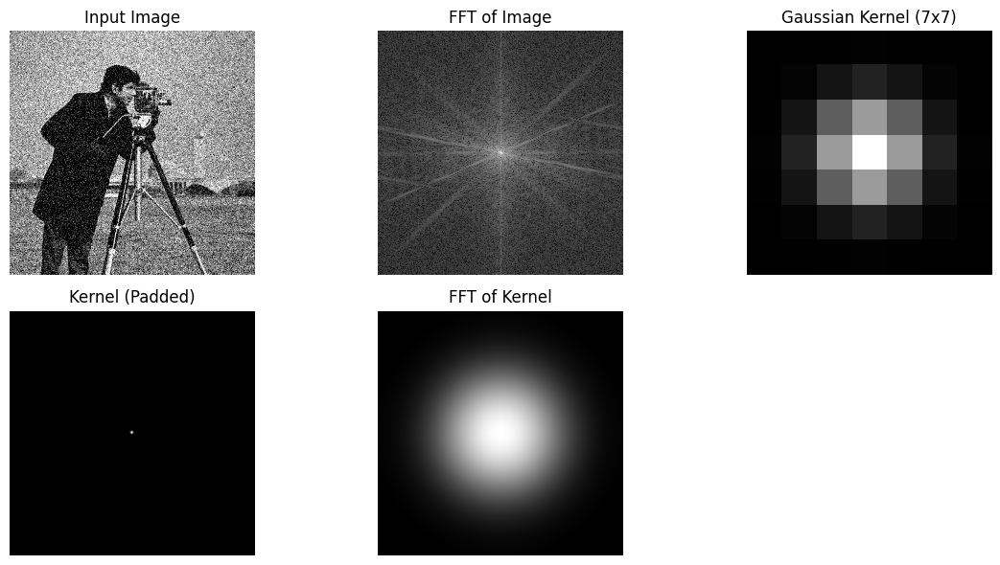

In [23]:
kern = gaussian_kernel(7, sigma=1)
# Pad kernel to match image size, centered
pad_kern = np.zeros_like(img, dtype=np.float32)
kh, kw = kern.shape
r, c = img.shape

# # Compute starting indices for centering
start_x = (r - kh) // 2
start_y = (c - kw) // 2

pad_kern[start_x:start_x+kh, start_y:start_y+kw] = kern


# Compute FFTs
fshift_img, mag_img = compute_fft(img_gauss_smallest)
fshift_kern, mag_kern = compute_fft(pad_kern)

# Plot results1
plt.figure(figsize=(12,6))

plt.subplot(2,3,1)
plt.imshow(img_gauss, cmap='gray')
plt.title("Input Image")
plt.axis('off')

plt.subplot(2,3,2)
plt.imshow(mag_img, cmap='gray')
plt.title("FFT of Image")
plt.axis('off')

plt.subplot(2,3,3)
plt.imshow(kern, cmap='gray')
plt.title("Gaussian Kernel (7x7)")
plt.axis('off')

plt.subplot(2,3,4)
plt.imshow(pad_kern, cmap='gray')
plt.title("Kernel (Padded)")
plt.axis('off')

plt.subplot(2,3,5)
plt.imshow(mag_kern, cmap='gray')
plt.title("FFT of Kernel")
plt.axis('off')

plt.tight_layout()
plt.show()

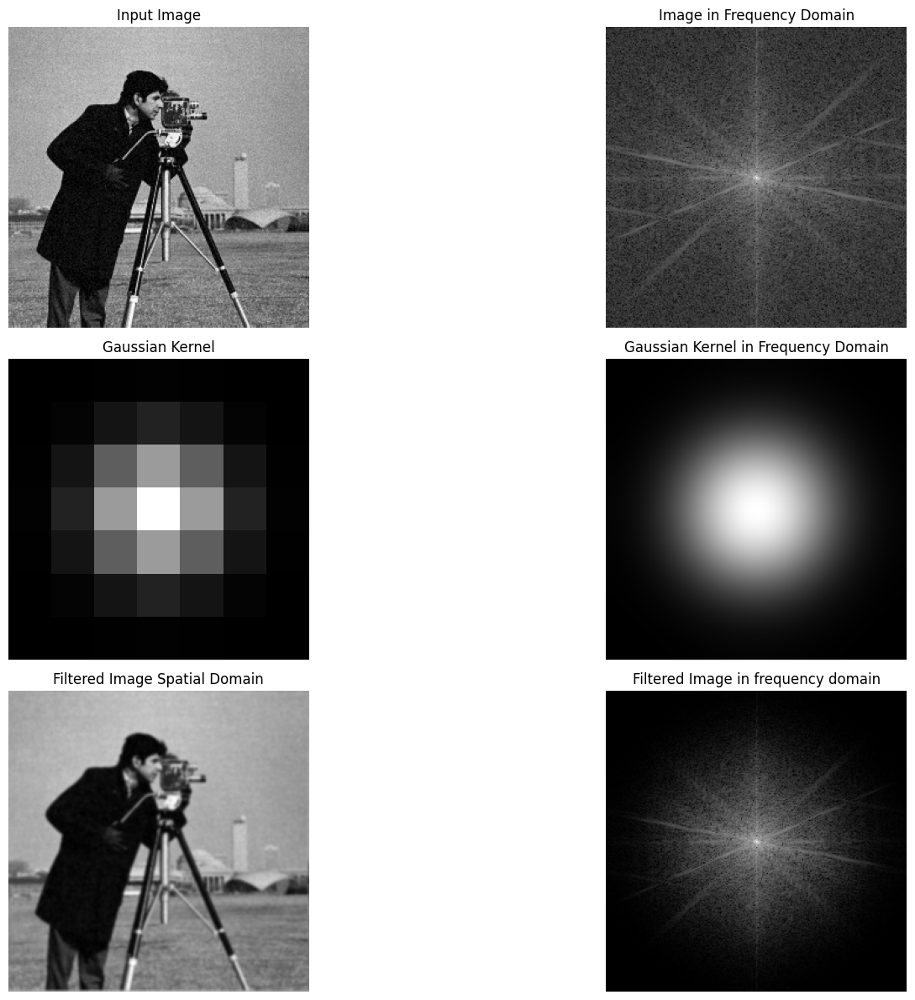

In [24]:
# Filtering in frequency domain
filtered_fft = fshift_img * fshift_kern
filtered_fft_mag = np.log(np.abs(filtered_fft) + 1)
filtered_img = np.fft.ifft2(np.fft.ifftshift(filtered_fft))
filtered_img = np.abs(fftshift(filtered_img))

# Show results
plt.figure(figsize=(18,12))
plt.subplot(3,2,1)
plt.imshow(img_gauss_smallest, cmap='gray')
plt.title("Input Image")
plt.axis('off')

plt.subplot(3,2,2)
plt.imshow(mag_img, cmap='gray')
plt.title("Image in Frequency Domain")
plt.axis('off')

plt.subplot(3,2,3)
plt.imshow(kern, cmap='gray')
plt.title("Gaussian Kernel")
plt.axis('off')

plt.subplot(3,2,4)
plt.imshow(mag_kern, cmap='gray')
plt.title("Gaussian Kernel in Frequency Domain")
plt.axis('off')


plt.subplot(3,2,5)
plt.imshow(filtered_img, cmap='gray')
plt.title("Filtered Image Spatial Domain")
plt.axis('off')

plt.subplot(3,2,6)
plt.imshow(filtered_fft_mag, cmap='gray')
plt.title("Filtered Image in frequency domain")
plt.axis('off')
plt.tight_layout()
plt.show()

plt.imsave("filtered_fft_mag.png", filtered_fft_mag, cmap="gray")
plt.imsave("filtered_img.png", filtered_img, cmap="gray")

## 4) Discussion & comparisons

- Median filtering is non-linear and cannot be represented simply as multiplication in the frequency domain.
- Bilateral filter is also non-linear and edge-preserving;

**Explain briefly from the formula of Bilateral Filtering, why Bilateral Filtering is non-linear**

Write Answer Here.

### Bilateral Filter

The bilateral filter computes the output intensity at a pixel $p$ as:

$$
I_{out}(p) = \frac{1}{W_p} \sum_{q \in \Omega} I(q) \;
\exp\left(-\frac{\|p-q\|^2}{2\sigma_s^2}\right) \;
\exp\left(-\frac{(I(p)-I(q))^2}{2\sigma_r^2}\right)
$$

where:

$$
W_p = \sum_{q \in \Omega}
\exp\left(-\frac{\|p-q\|^2}{2\sigma_s^2}\right) \;
\exp\left(-\frac{(I(p)-I(q))^2}{2\sigma_r^2}\right)
$$


Since the filter weights depend explicitly on the image intensity values, the operation cannot be expressed as a linear convolution with fixed coefficients. In particular, the bilateral filter does not satisfy the principle of superposition:

$$
\mathcal{B}(I_1 + I_2) \neq \mathcal{B}(I_1) + \mathcal{B}(I_2),
$$

where $ \mathcal{B}(\cdot) $ denotes the bilateral filtering operation.

Therefore, because the weights are data-dependent and vary with the input image, bilateral filtering is a $\textbf{non-linear}$ filtering operation.


### Exercises (Try-it-yourself)

---

#### 1. Spatial vs Frequency Domain Filtering

- Perform **spatial-domain filtering (convolution)** on an image using:
  - Box (uniform) filter  
  - Gaussian filter  

- Perform the **same filtering via frequency-domain multiplication**:
  - Take the Fourier transform of the image and of the filter  
  - Multiply them  
  - Apply the inverse FFT  

- Compare:
  - Spatial vs frequency-domain results (visual comparison and quantitative metrics like **MSE** or **PSNR**)  
  - Does the Fourier-domain implementation reproduce spatial convolution exactly?  
  - Explain differences if any

- Plot:
  - Magnitude spectrum of the Fourier transform (log magnitude / dB) for **Box filter** and **Gaussian filter**  
  - Discuss which filter is “better” and why, based on their frequency response.  

- Apply both filters to several test images:
  - Include at least one image with strong **high-frequency content** (e.g., checkerboard, text).  
  - Discuss differences (edge blurring, ringing artifacts, texture preservation, etc.).  

---

#### 2. Fourier Transform of Simple and Real Images

- Take **5 images** of your choice:
  - **3 simple signals** (easy to compute Fourier transforms analytically)  
    - Examples: Rectangular box, Circular disk, Exponential decay, Circular ring, Single line, etc.  
  - **2 natural images** of your choice (e.g., low-light, noisy, rainy, etc.)  

- Tasks:
  - Compute and visualize their Fourier transforms.  
  - List observations about frequency content.  
  - (Tip: resize large images → Fourier transform is slow on large inputs).  

- Tasks:
  - Translate the image in spatial domain and check it's corresponding frequency domain
  - Rotate the image in spatial domain and check it's corresponding frequency domain
---

#### 3. Frequency-Domain High-Pass Filtering

- Implement a **frequency-domain high-pass filter** defined as:  

  $$
  H_{\text{high-pass}}(u,v) = 1 - H_{\text{low-pass}}(u,v)
  $$

- Use low-pass filters:
  - Gaussian  
  - Box blur  

- Apply the high-pass filter to an image.  
- Add the filtered result back to the original image to observe **edge enhancement**.  

---


#### 1. Spatial vs Frequency Domain Filtering

- Perform **spatial-domain filtering (convolution)** on an image using:
  - Box (uniform) filter  
  - Gaussian filter  

(375, 500)


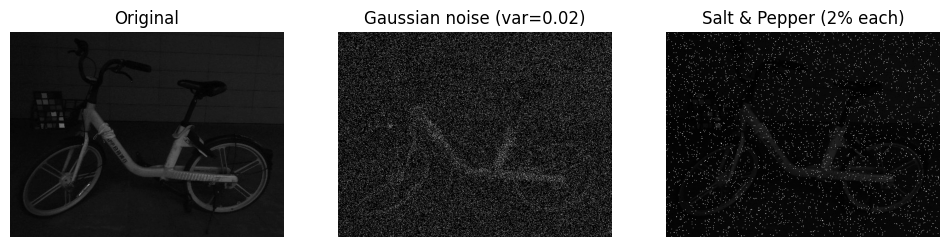

In [36]:
# Load image and show noisy versions
img = load_gray_image("bike.JPG")
np.random.seed(0)

img_gauss = add_gaussian_noise(img, var=0.02)
img_sp = add_salt_pepper_noise(img, salt_prob=0.02, pepper_prob=0.02)

plt.figure(figsize=(12,4))
plt.subplot(1,3,1); plt.imshow(img, cmap='gray'); plt.title('Original'); plt.axis('off')
plt.subplot(1,3,2); plt.imshow(img_gauss, cmap='gray'); plt.title('Gaussian noise (var=0.02)'); plt.axis('off')
plt.subplot(1,3,3); plt.imshow(img_sp, cmap='gray'); plt.title('Salt & Pepper (2% each)'); plt.axis('off')
plt.show()

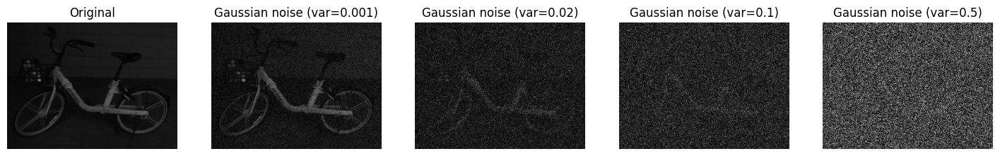

In [38]:
img_gauss_smallest = add_gaussian_noise(img, var=0.001)
img_gauss_small = add_gaussian_noise(img, var = 0.02)
img_gauss_med = add_gaussian_noise(img, var = 0.1)
img_gauss_large = add_gaussian_noise(img, var = 0.5)

plt.figure(figsize=(18, 12))
plt.subplot(1,5,1); plt.imshow(img, cmap='gray'); plt.title('Original'); plt.axis('off')
plt.subplot(1,5,2); plt.imshow(img_gauss_smallest, cmap='gray'); plt.title('Gaussian noise (var=0.001)'); plt.axis('off')
plt.subplot(1,5,3); plt.imshow(img_gauss_small, cmap='gray'); plt.title('Gaussian noise (var=0.02)'); plt.axis('off')
plt.subplot(1,5,4); plt.imshow(img_gauss_med, cmap='gray'); plt.title('Gaussian noise (var=0.1)'); plt.axis('off')
plt.subplot(1,5,5); plt.imshow(img_gauss_large, cmap='gray'); plt.title('Gaussian noise (var=0.5)'); plt.axis('off')
plt.show()

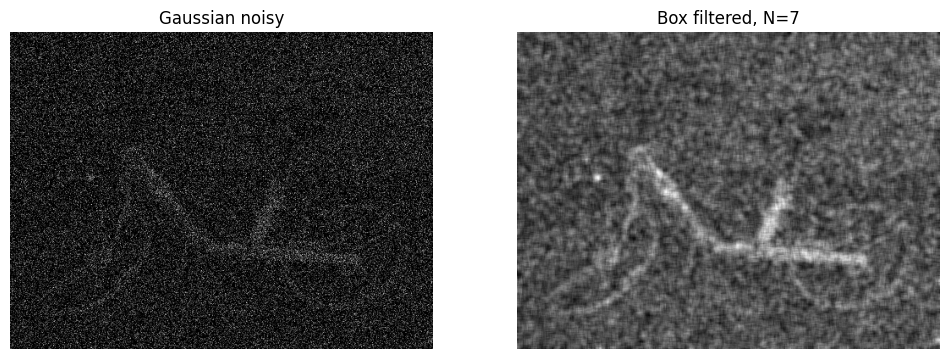

In [55]:
# Box Filter
N1 = 7
N2 = 5
kern_1 = np.ones((N1, N1)) / (N1*N1)
kern_2 = np.ones((N2, N2)) / (N2*N2)
box_from_manual_1 = convolve(img_gauss, kern_1, mode='reflect')
box_from_manual_2 = convolve(img_gauss, kern_2, mode='reflect')

# Show
plt.figure(figsize=(12,6))
plt.subplot(1,2,1); plt.imshow(img_gauss, cmap='gray'); plt.title('Gaussian noisy'); plt.axis('off')
plt.subplot(1,2,2); plt.imshow(box_from_manual_1, cmap='gray'); plt.title('Box filtered, N=7'); plt.axis('off')
# plt.subplot(1,3,3); plt.imshow(box_from_manual_2, cmap='gray'); plt.title('Box filtered, N=5'); plt.axis('off')

plt.show()

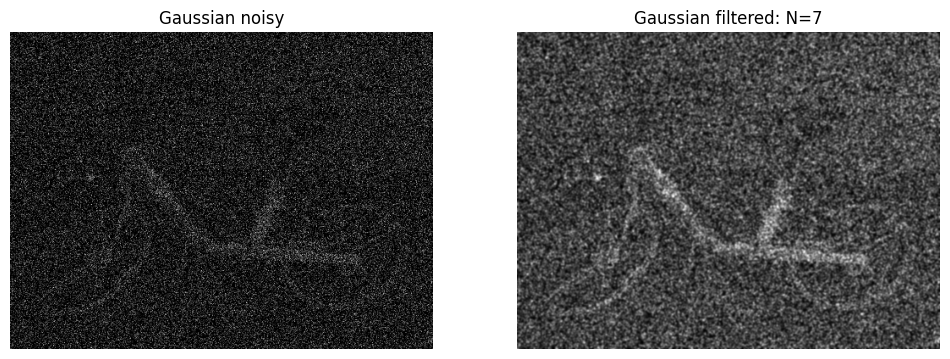

In [56]:
# Gaussian filter manual (convolution)
kern_1 = gaussian_kernel(7, sigma=1)
gauss_from_manual_1 = convolve(img_gauss, kern_1, mode='reflect')


# Show
plt.figure(figsize=(12,6))
plt.subplot(1,2,1); plt.imshow(img_gauss, cmap='gray'); plt.title('Gaussian noisy'); plt.axis('off')
plt.subplot(1,2,2); plt.imshow(gauss_from_manual_1, cmap='gray'); plt.title('Gaussian filtered: N=7'); plt.axis('off')
# plt.subplot(1,3,3); plt.imshow(gauss_from_manual_2, cmap='gray'); plt.title('Gaussian filtered: N=5'); plt.axis('off')
# plt.subplot(1,4,4); plt.imshow(bilat, cmap='gray'); plt.title('Bilateral (OpenCV)'); plt.axis('off')
plt.show()

- Perform the **same filtering via frequency-domain multiplication**:
  - Take the Fourier transform of the image and of the filter  
  - Multiply them  
  - Apply the inverse FFT

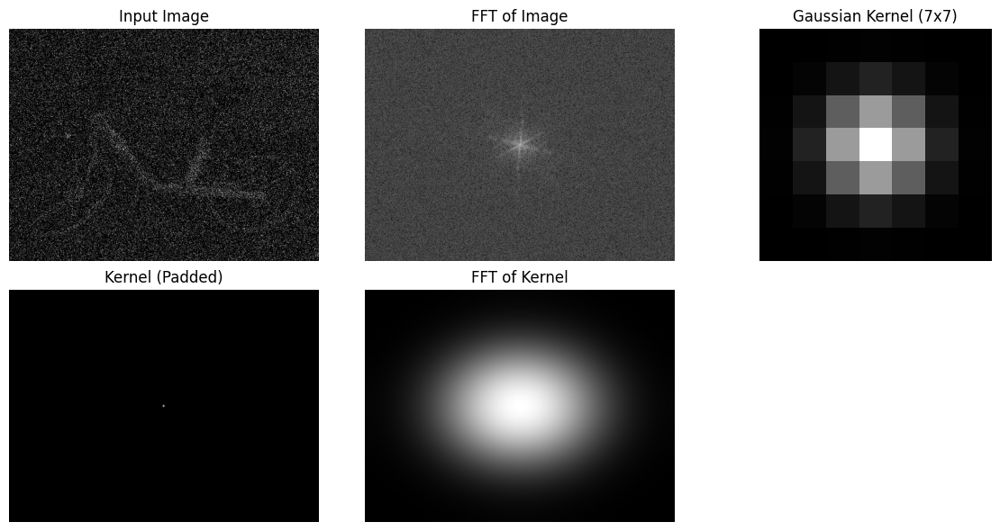

In [57]:
kern = gaussian_kernel(7, sigma=1)
# Pad kernel to match image size, centered
pad_kern = np.zeros_like(img, dtype=np.float32)
kh, kw = kern.shape
r, c = img.shape

# # Compute starting indices for centering
start_x = (r - kh) // 2
start_y = (c - kw) // 2

pad_kern[start_x:start_x+kh, start_y:start_y+kw] = kern


# Compute FFTs
fshift_img, mag_img = compute_fft(img_gauss_smallest)
fshift_kern, mag_kern = compute_fft(pad_kern)

# Plot results1
plt.figure(figsize=(12,6))

plt.subplot(2,3,1)
plt.imshow(img_gauss, cmap='gray')
plt.title("Input Image")
plt.axis('off')

plt.subplot(2,3,2)
plt.imshow(mag_img, cmap='gray')
plt.title("FFT of Image")
plt.axis('off')

plt.subplot(2,3,3)
plt.imshow(kern, cmap='gray')
plt.title("Gaussian Kernel (7x7)")
plt.axis('off')

plt.subplot(2,3,4)
plt.imshow(pad_kern, cmap='gray')
plt.title("Kernel (Padded)")
plt.axis('off')

plt.subplot(2,3,5)
plt.imshow(mag_kern, cmap='gray')
plt.title("FFT of Kernel")
plt.axis('off')

plt.tight_layout()
plt.show()

In [58]:
# Kernel must be shifted to (0,0) first
kern_shifted = np.fft.ifftshift(pad_kern)

# Unshifted FFTs
F_img  = np.fft.fft2(img_gauss)
F_kern = np.fft.fft2(kern_shifted)

# Frequency-domain multiplication
F_mult = F_img * F_kern


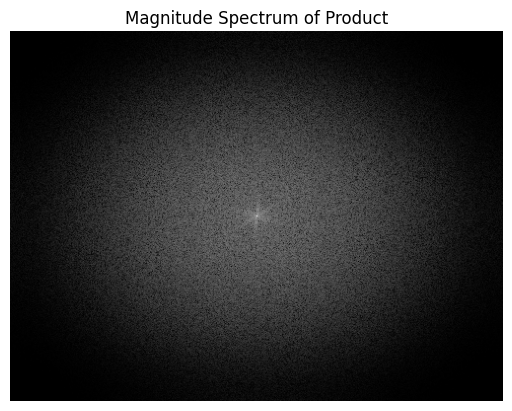

In [59]:
mag_mult = np.log(1 + np.abs(np.fft.fftshift(F_mult)))

plt.imshow(mag_mult, cmap='gray')
plt.title("Magnitude Spectrum of Product")
plt.axis('off')
plt.show()


In [60]:
img_freq = np.fft.ifft2(F_mult)
img_freq = np.real(img_freq)


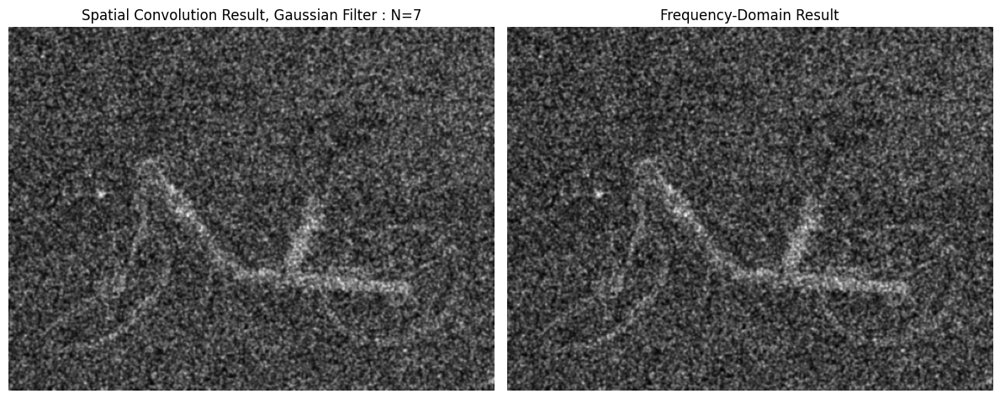

In [62]:
plt.figure(figsize=(12,6))

plt.subplot(1,2,1)
plt.imshow(gauss_from_manual_1, cmap='gray')
plt.title("Spatial Convolution Result, Gaussian Filter : N=7")
plt.axis('off')

plt.subplot(1,2,2)
plt.imshow(img_freq, cmap='gray')
plt.title("Frequency-Domain Result")
plt.axis('off')



plt.tight_layout()
plt.show()


In [63]:
mse = np.mean((gauss_from_manual_1 - img_freq) ** 2)
print("MSE:", mse)


MSE: 0.00031271297


In [64]:
MAX_I = gauss_from_manual_1.max()
psnr = 20 * np.log10(MAX_I / np.sqrt(mse))
print("PSNR:", psnr, "dB")


PSNR: 23.509918 dB


- Plot:
  - Magnitude spectrum of the Fourier transform (log magnitude / dB) for **Box filter** and **Gaussian filter**  
  - Discuss which filter is “better” and why, based on their frequency response.

In [65]:
kern = gaussian_kernel(7, sigma=1)
# Pad kernel to match image size, centered
pad_kern = np.zeros_like(img, dtype=np.float32)
kh, kw = kern.shape
r, c = img.shape

# # Compute starting indices for centering
start_x = (r - kh) // 2
start_y = (c - kw) // 2

pad_kern[start_x:start_x+kh, start_y:start_y+kw] = kern


# Compute FFTs
# fshift_img, mag_img = compute_fft(img_gauss_smallest)
fshift_kern, mag_kern = compute_fft(pad_kern)

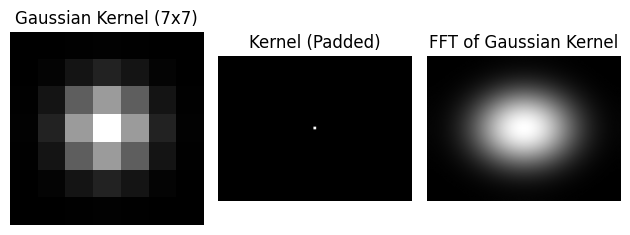

In [71]:
plt.subplot(1,3,1)
plt.imshow(kern, cmap='gray')
plt.title("Gaussian Kernel (7x7)")
plt.axis('off')

plt.subplot(1,3,2)
plt.imshow(pad_kern, cmap='gray')
plt.title("Kernel (Padded)")
plt.axis('off')

plt.subplot(1,3,3)
plt.imshow(mag_kern, cmap='gray')
plt.title("FFT of Gaussian Kernel")
plt.axis('off')

plt.tight_layout()
plt.show()

In [72]:
# Box Filter
N = 7
kern_box= np.ones((N, N)) / (N*N)
# Pad kernel to match image size, centered
pad_kern_box = np.zeros_like(img, dtype=np.float32)
kh, kw = kern_box.shape
r, c = img.shape

# # Compute starting indices for centering
start_x = (r - kh) // 2
start_y = (c - kw) // 2

pad_kern_box[start_x:start_x+kh, start_y:start_y+kw] = kern_box


# Compute FFTs
# fshift_img, mag_img = compute_fft(img_gauss_smallest)
fshift_kern_box, mag_kern_box = compute_fft(pad_kern)

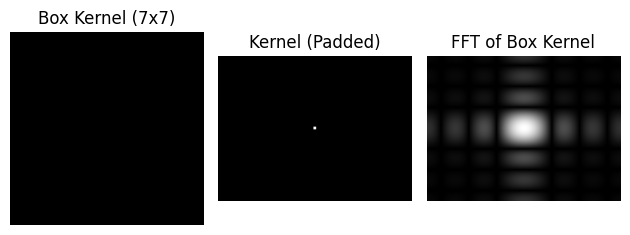

In [73]:
plt.subplot(1,3,1)
plt.imshow(kern_box, cmap='gray')
plt.title("Box Kernel (7x7)")
plt.axis('off')

plt.subplot(1,3,2)
plt.imshow(pad_kern_box, cmap='gray')
plt.title("Kernel (Padded)")
plt.axis('off')

plt.subplot(1,3,3)
plt.imshow(mag_kern_box, cmap='gray')
plt.title("FFT of Box Kernel")
plt.axis('off')

plt.tight_layout()
plt.show()

- Apply both filters to several test images:
  - Include at least one image with strong **high-frequency content** (e.g., checkerboard, text).  
  - Discuss differences (edge blurring, ringing artifacts, texture preservation, etc.).

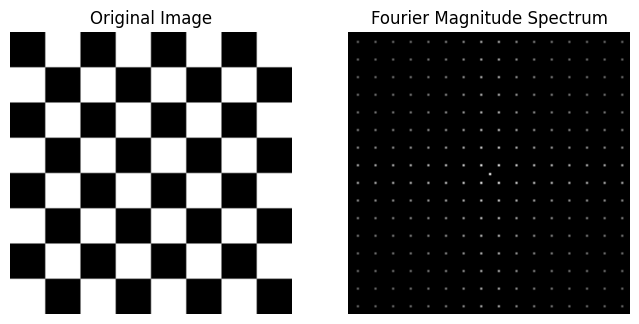

In [74]:
# Example usage
chessboard_img = generate_chessboard(size=128, num_squares=8)
save_and_plot_fft(chessboard_img, "chessboard", "chessboard_spectrum")

In [79]:
kern = gaussian_kernel(7, sigma=1)
# Pad kernel to match image size, centered
pad_kern = np.zeros_like(chessboard_img, dtype=np.float32)
kh, kw = kern.shape
r, c = chessboard_img.shape

# # Compute starting indices for centering
start_x = (r - kh) // 2
start_y = (c - kw) // 2

pad_kern[start_x:start_x+kh, start_y:start_y+kw] = kern

# Box Filter
N = 7
kern_box= np.ones((N, N)) / (N*N)
# Pad kernel to match image size, centered
pad_kern_box = np.zeros_like(chessboard_img, dtype=np.float32)
kh, kw = kern_box.shape
r, c = chessboard_img.shape

# # Compute starting indices for centering
start_x = (r - kh) // 2
start_y = (c - kw) // 2

pad_kern_box[start_x:start_x+kh, start_y:start_y+kw] = kern_box


# Compute FFTs
# fshift_img, mag_img = compute_fft(img_gauss_smallest)
# fshift_kern_box, mag_kern_box = compute_fft(pad_kern)


In [81]:
# Kernel must be shifted to (0,0) first
kern_shifted = np.fft.ifftshift(pad_kern)

# Unshifted FFTs
F_img  = np.fft.fft2(chessboard_img)
F_kern = np.fft.fft2(kern_shifted)

# Frequency-domain multiplication
F_mult = F_img * F_kern
img_freq = np.fft.ifft2(F_mult)
img_freq = np.real(img_freq)

mag_mult = np.log(1 + np.abs(np.fft.fftshift(F_mult)))


In [82]:
# Kernel must be shifted to (0,0) first
kern_shifted_box = np.fft.ifftshift(pad_kern_box)

# Unshifted FFTs
F_img  = np.fft.fft2(chessboard_img)
F_kern_box = np.fft.fft2(kern_shifted_box)

# Frequency-domain multiplication
F_mult_box = F_img * F_kern_box
img_freq_box = np.fft.ifft2(F_mult_box)
img_freq_box = np.real(img_freq_box)

mag_mult_box = np.log(1 + np.abs(np.fft.fftshift(F_mult_box)))



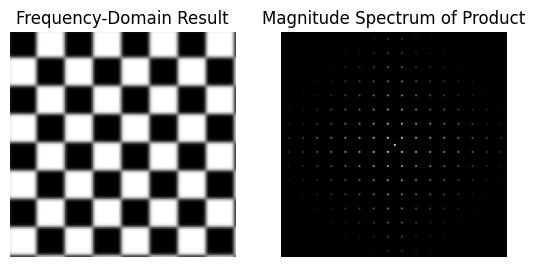

In [83]:
plt.subplot(1,2,1)
plt.imshow(img_freq, cmap='gray')
plt.title("Frequency-Domain Result")
plt.axis('off')

plt.subplot(1,2,2)
plt.imshow(mag_mult, cmap='gray')
plt.title("Magnitude Spectrum of Product")
plt.axis('off')
plt.show()

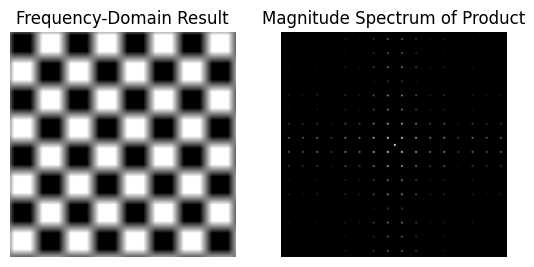

In [84]:
plt.subplot(1,2,1)
plt.imshow(img_freq_box, cmap='gray')
plt.title("Frequency-Domain Result")
plt.axis('off')

plt.subplot(1,2,2)
plt.imshow(mag_mult_box, cmap='gray')
plt.title("Magnitude Spectrum of Product")
plt.axis('off')
plt.show()

#### 2. Fourier Transform of Simple and Real Images

- Take **5 images** of your choice:
  - **3 simple signals** (easy to compute Fourier transforms analytically)  
    - Examples: Rectangular box, Circular disk, Exponential decay, Circular ring, Single line, etc.  
  - **2 natural images** of your choice (e.g., low-light, noisy, rainy, etc.)  

- Tasks:
  - Compute and visualize their Fourier transforms.  
  - List observations about frequency content.  
  - (Tip: resize large images → Fourier transform is slow on large inputs).  

In [85]:
def rectangular_box(size=256, box_size=60):
    img = np.zeros((size, size), dtype=np.float32)
    c = size // 2
    h = box_size // 2
    img[c-h:c+h, c-h:c+h] = 1.0
    return img


In [86]:
def exponential_decay(size=256, alpha=0.05):
    x = np.linspace(-size//2, size//2, size)
    X, Y = np.meshgrid(x, x)
    R = np.sqrt(X**2 + Y**2)
    img = np.exp(-alpha * R)
    return img


In [87]:
def circular_disk(size=256, radius=40):
    img = np.zeros((size, size), dtype=np.float32)
    x = np.linspace(-size//2, size//2, size)
    X, Y = np.meshgrid(x, x)
    R = np.sqrt(X**2 + Y**2)
    img[R <= radius] = 1.0
    return img


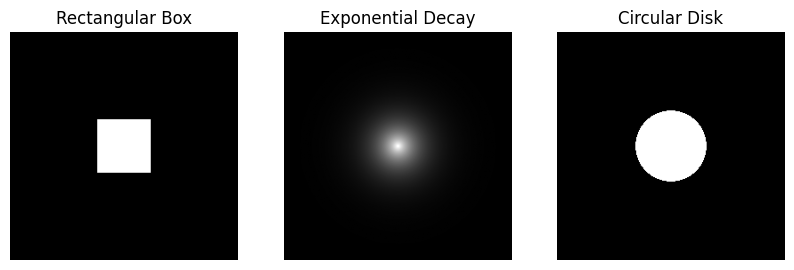

In [88]:
signals = {
    "Rectangular Box": rectangular_box(),
    "Exponential Decay": exponential_decay(),
    "Circular Disk": circular_disk()
}

plt.figure(figsize=(10,3))
for i, (name, img) in enumerate(signals.items()):
    plt.subplot(1,3,i+1)
    plt.imshow(img, cmap='gray')
    plt.title(name)
    plt.axis('off')
plt.show()


(375, 500)
(972, 1296)


(np.float64(-0.5), np.float64(1295.5), np.float64(971.5), np.float64(-0.5))

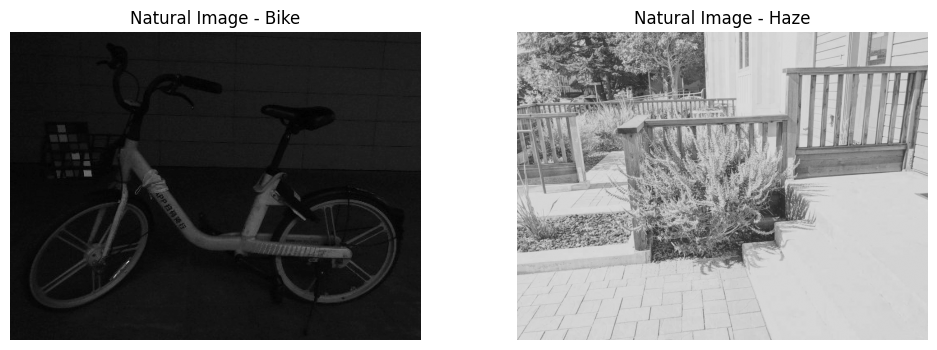

In [90]:
img_bike = load_gray_image("bike.JPG")
img_haze = load_gray_image("haze.png")


plt.figure(figsize=(12,4))
plt.subplot(1,2,1); plt.imshow(img_bike, cmap='gray'); plt.title('Natural Image - Bike'); plt.axis('off')
plt.subplot(1,2,2); plt.imshow(img_haze, cmap='gray'); plt.title('Natural Image - Haze'); plt.axis('off')

In [91]:
def resize_for_fft(img, size=256):
    return cv2.resize(img, (size, size), interpolation=cv2.INTER_AREA)


<Figure size 1000x300 with 0 Axes>

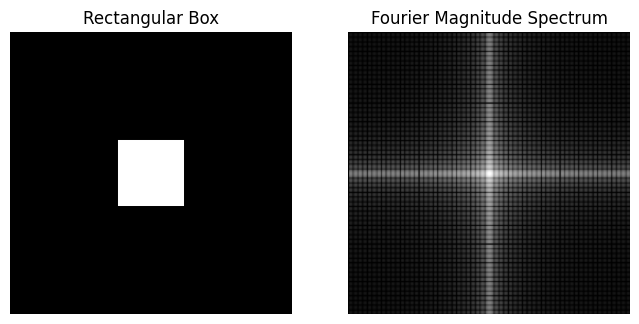

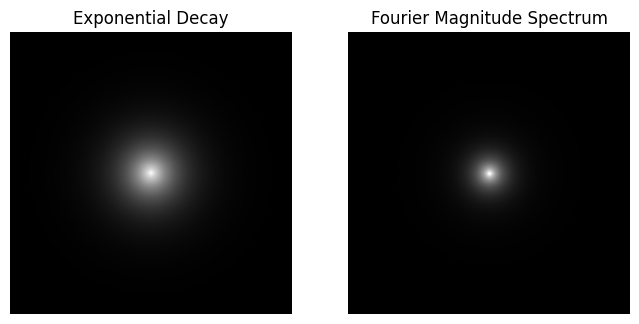

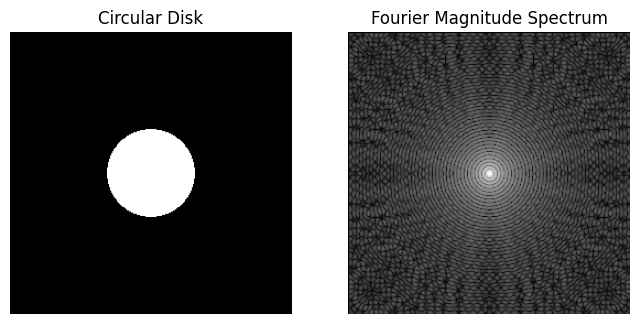

In [94]:
signals = {
    "Rectangular Box": rectangular_box(),
    "Exponential Decay": exponential_decay(),
    "Circular Disk": circular_disk()
}

plt.figure(figsize=(10,3))
for i, (name, img) in enumerate(signals.items()):
    save_and_plot_fft(img, f'{name}', "spectrum"+str(name) )



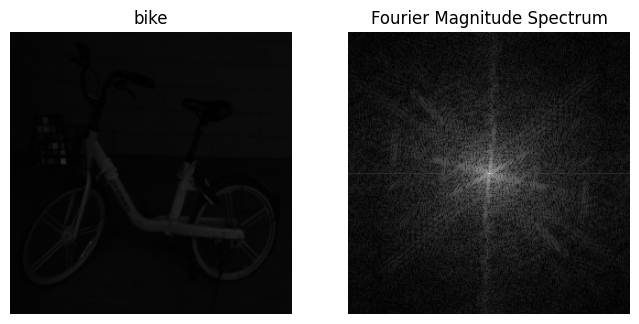

In [95]:
save_and_plot_fft(resize_for_fft(img_bike), "bike", "bike_spectrum")

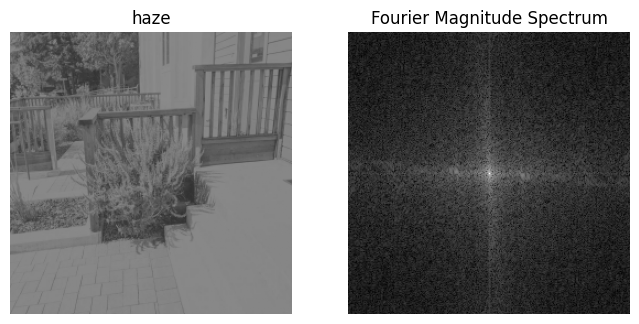

In [96]:
save_and_plot_fft(resize_for_fft(img_haze), "haze", "haze_spectrum")

### Observations

**Rectangular Box**

- Sharp spatial discontinuities result in strong high-frequency components.

- Fourier transform exhibits a sinc-like pattern with oscillations.

- Energy spreads across frequencies due to sharp edges.

**Exponential Decay**

- Smooth spatial variation concentrates energy near low frequencies.

- Fourier spectrum decays smoothly without oscillations.

- Indicates dominance of low-frequency components.

**Circular Disk**

- Radial symmetry in spatial domain leads to radial symmetry in frequency domain.

- Fourier transform exhibits concentric ring patterns.

- Demonstrates isotropy of the object.

**Natural Images**

- Most energy concentrated near the origin (low frequencies).

- Edges and noise contribute to higher frequencies.

- Structured textures appear as oriented frequency component

- Tasks:
  - Translate the image in spatial domain and check it's corresponding frequency domain
  - Rotate the image in spatial domain and check it's corresponding frequency domain

In [103]:
def translate_and_plot_fft(img, tx, ty):
    """
    Translate image by (tx, ty) and visualize spatial image,
    FFT magnitude, and FFT phase
    """
    import numpy as np
    import matplotlib.pyplot as plt

    # Spatial translation (circular shift)
    img_trans = np.roll(img, shift=(ty, tx), axis=(0, 1))

    # FFTs
    F_orig = np.fft.fftshift(np.fft.fft2(img))
    F_trans = np.fft.fftshift(np.fft.fft2(img_trans))

    # Magnitude and phase
    mag_orig = np.log(1 + np.abs(F_orig))
    mag_trans = np.log(1 + np.abs(F_trans))

    phase_orig = np.angle(F_orig)
    phase_trans = np.angle(F_trans)

    # Plot
    plt.figure(figsize=(14,8))

    plt.subplot(2,3,1)
    plt.imshow(img, cmap='gray')
    plt.title("Original Image")
    plt.axis('off')

    plt.subplot(2,3,2)
    plt.imshow(img_trans, cmap='gray')
    plt.title(f"Translated Image (tx={tx}, ty={ty})")
    plt.axis('off')

    plt.subplot(2,3,3)
    plt.axis('off')

    plt.subplot(2,3,4)
    plt.imshow(mag_orig, cmap='gray')
    plt.title("FFT Magnitude (Original)")
    plt.axis('off')

    plt.subplot(2,3,5)
    plt.imshow(mag_trans, cmap='gray')
    plt.title("FFT Magnitude (Translated)")
    plt.axis('off')

    plt.subplot(2,3,6)
    plt.imshow(phase_trans - phase_orig, cmap='gray')
    plt.title("Phase Difference")
    plt.axis('off')

    plt.tight_layout()
    plt.show()


<Figure size 1000x300 with 0 Axes>

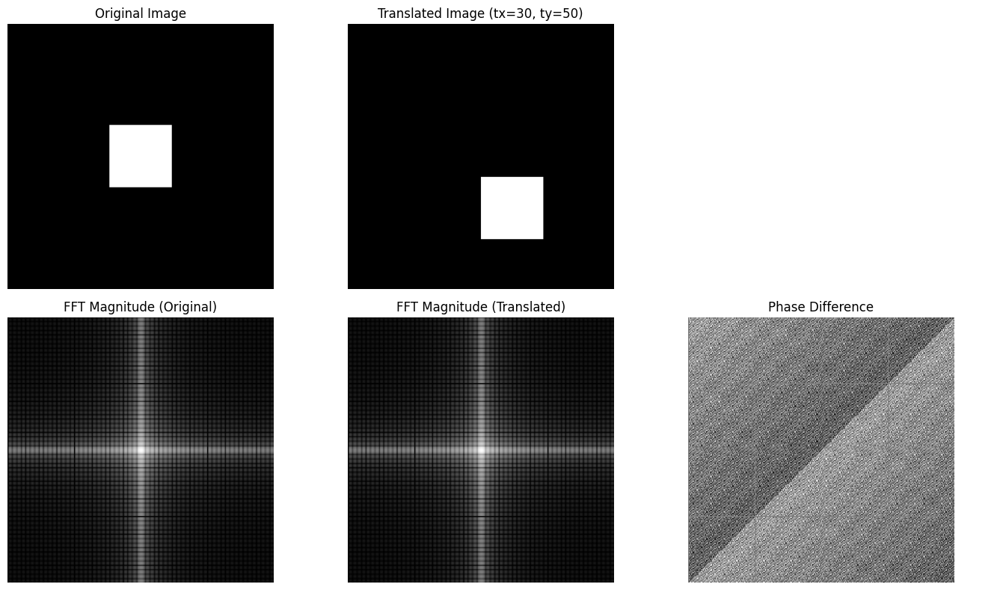

In [104]:
plt.figure(figsize=(10,3))
img = rectangular_box()

translate_and_plot_fft(img, 30, 50)

<Figure size 1000x300 with 0 Axes>

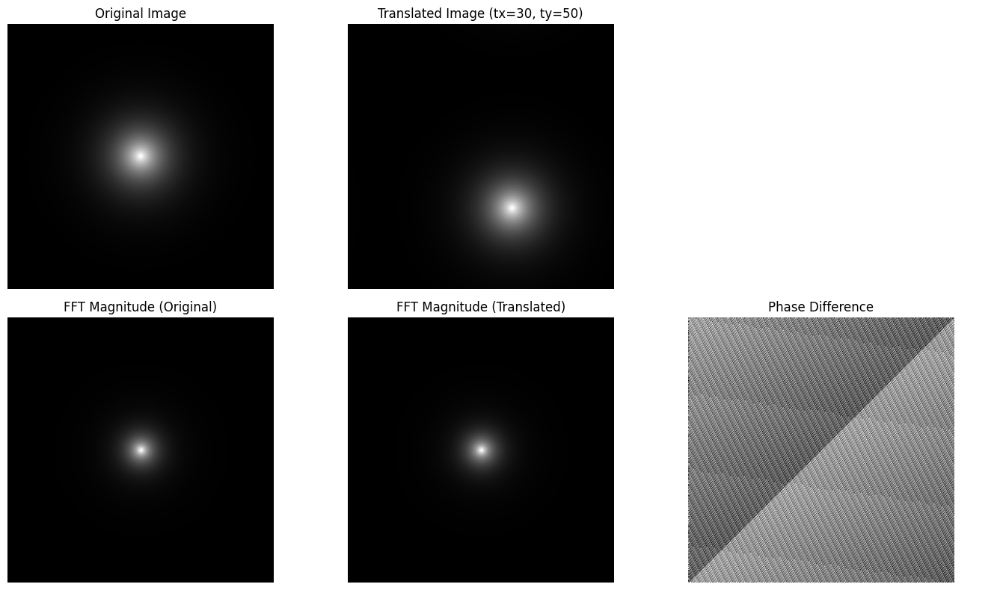

In [105]:
plt.figure(figsize=(10,3))
img = exponential_decay()

translate_and_plot_fft(img, 30, 50)

<Figure size 1000x300 with 0 Axes>

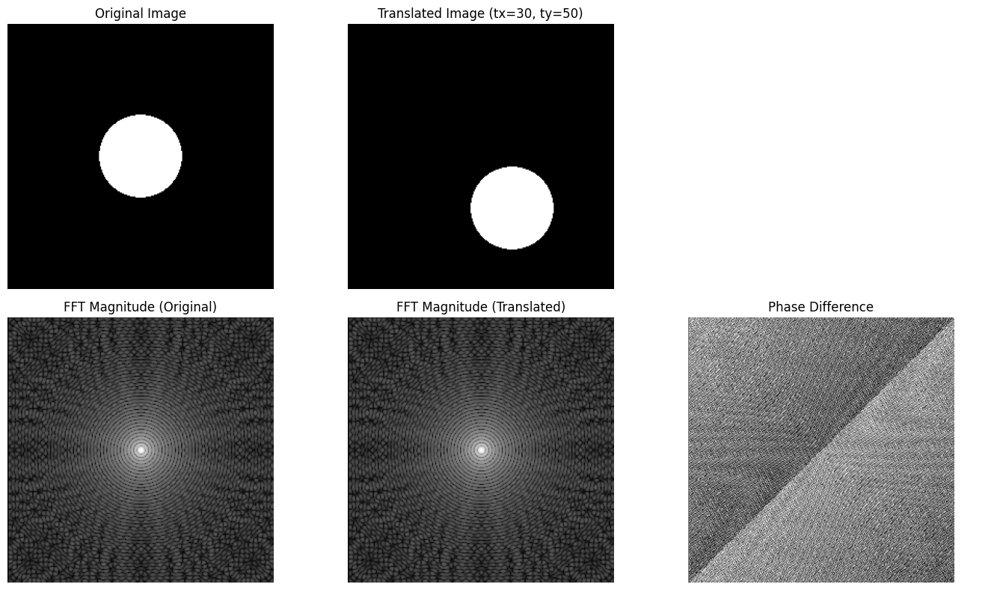

In [106]:
plt.figure(figsize=(10,3))
img = circular_disk()

translate_and_plot_fft(img, 30, 50)

<Figure size 1000x300 with 0 Axes>

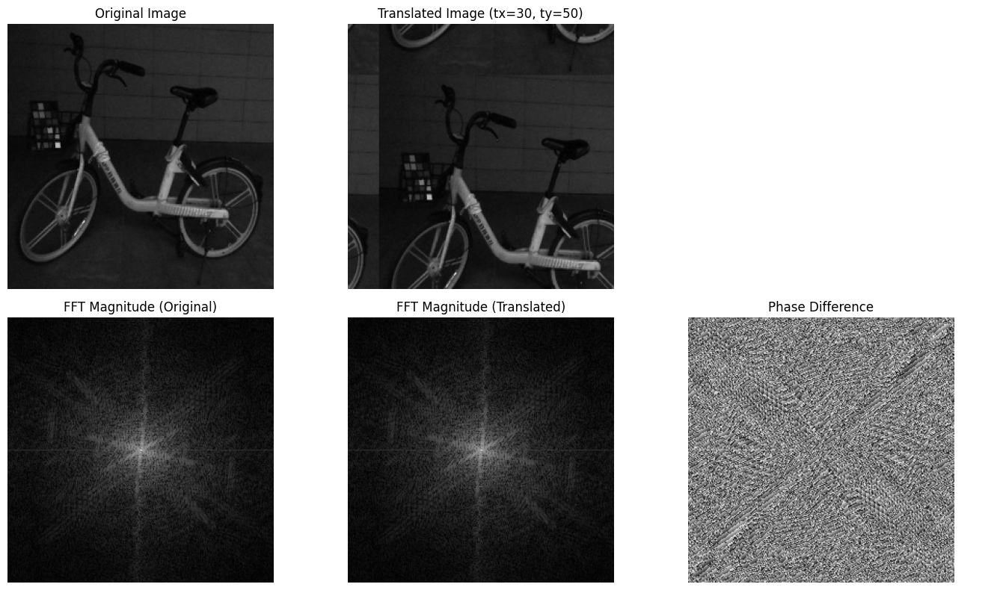

In [107]:
plt.figure(figsize=(10,3))

translate_and_plot_fft(resize_for_fft(img_bike), 30, 50)

<Figure size 1000x300 with 0 Axes>

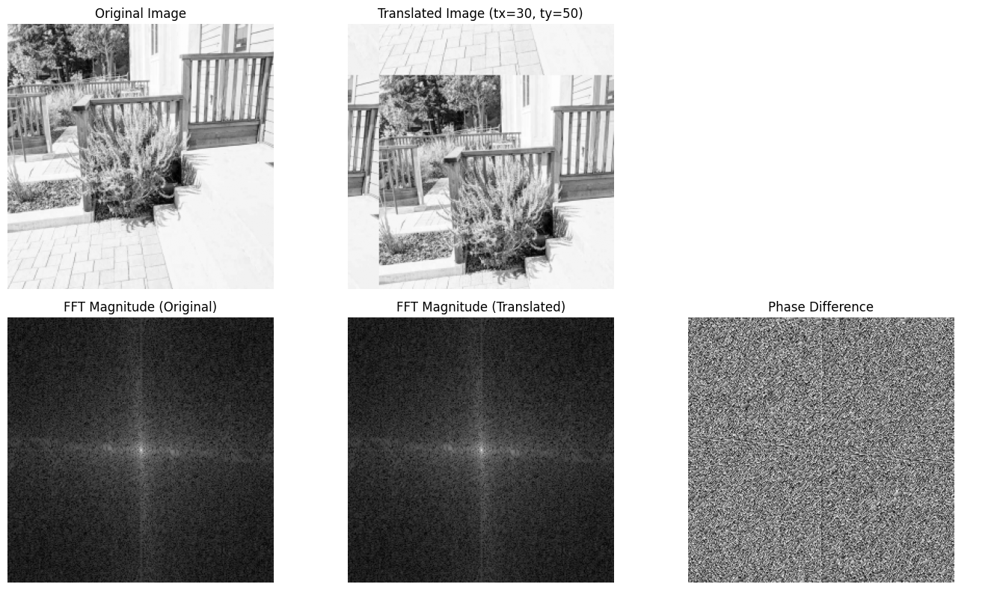

In [108]:
plt.figure(figsize=(10,3))

translate_and_plot_fft(resize_for_fft(img_haze), 30, 50)

In [111]:
def rotate_and_plot_fft(img, angle_deg):
    """
    Rotate image and visualize spatial image,
    FFT magnitude, and FFT phase
    """

    from scipy.ndimage import rotate

    # Rotate image (keep same size)
    img_rot = rotate(img, angle_deg, reshape=False, order=1)

    # FFTs
    F_orig = np.fft.fftshift(np.fft.fft2(img))
    F_rot = np.fft.fftshift(np.fft.fft2(img_rot))

    # Magnitude and phase
    mag_orig = np.log(1 + np.abs(F_orig))
    mag_rot = np.log(1 + np.abs(F_rot))

    phase_orig = np.angle(F_orig)
    phase_rot = np.angle(F_rot)

    # Plot
    plt.figure(figsize=(14,8))

    plt.subplot(2,3,1)
    plt.imshow(img, cmap='gray')
    plt.title("Original Image")
    plt.axis('off')

    plt.subplot(2,3,2)
    plt.imshow(img_rot, cmap='gray')
    plt.title(f"Rotated Image ({angle_deg}°)")
    plt.axis('off')

    plt.subplot(2,3,3)
    plt.axis('off')

    plt.subplot(2,3,4)
    plt.imshow(mag_orig, cmap='gray')
    plt.title("FFT Magnitude (Original)")
    plt.axis('off')

    plt.subplot(2,3,5)
    plt.imshow(mag_rot, cmap='gray')
    plt.title("FFT Magnitude (Rotated)")
    plt.axis('off')

    plt.subplot(2,3,6)
    plt.imshow(phase_rot, cmap='gray')
    plt.title("FFT Phase (Rotated)")
    plt.axis('off')

    plt.tight_layout()
    plt.show()


<Figure size 1000x300 with 0 Axes>

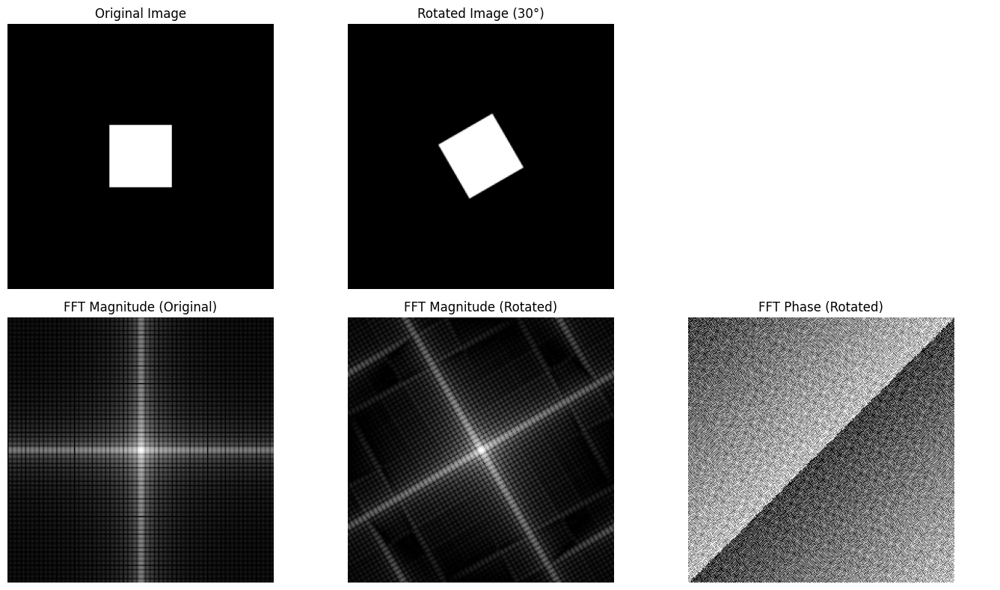

In [112]:
plt.figure(figsize=(10,3))
img = rectangular_box()

rotate_and_plot_fft(img, 30)



<Figure size 1000x300 with 0 Axes>

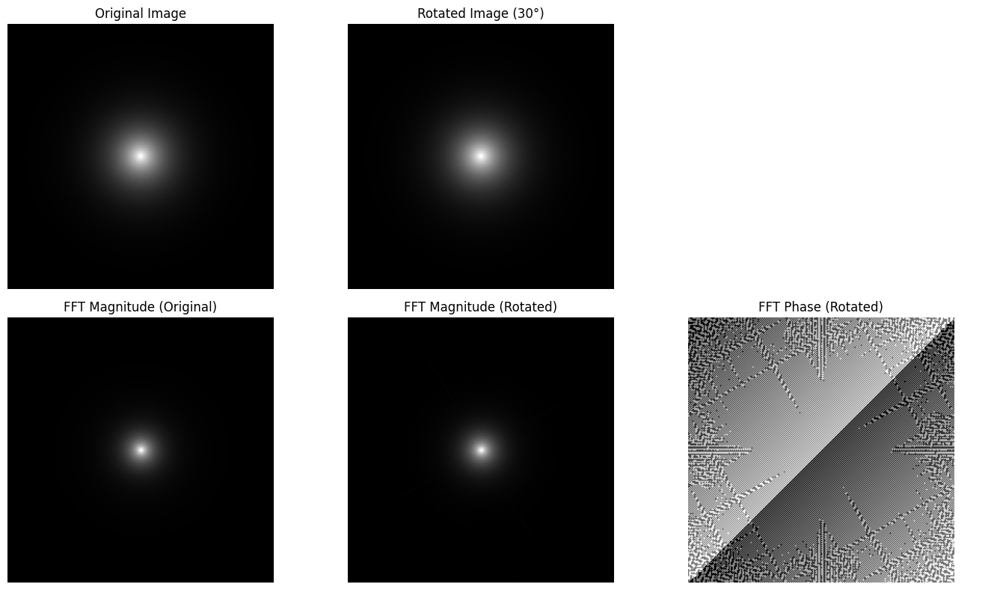

In [113]:
plt.figure(figsize=(10,3))
img = exponential_decay()

rotate_and_plot_fft(img, 30)



<Figure size 1000x300 with 0 Axes>

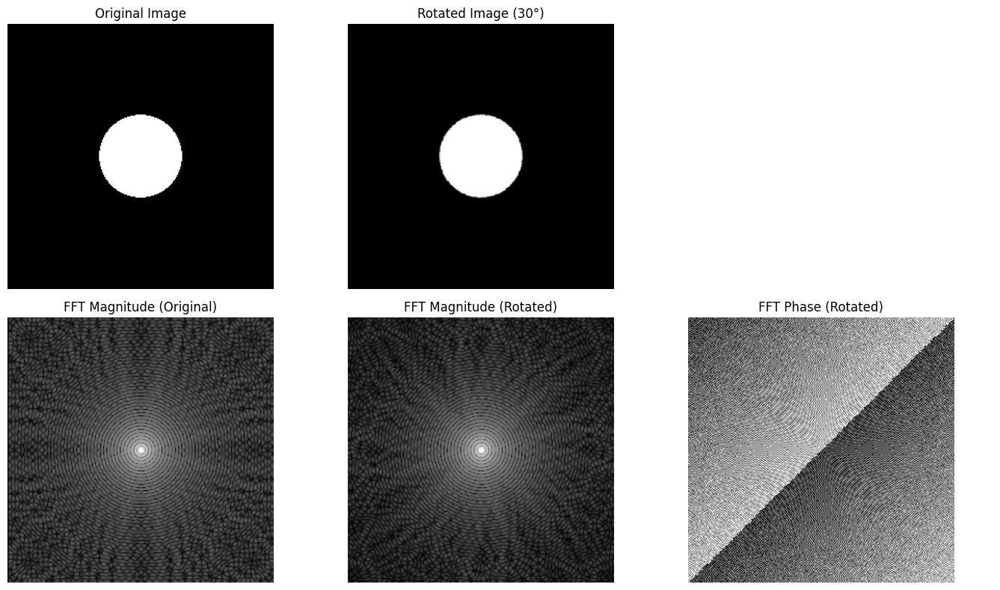

In [114]:
plt.figure(figsize=(10,3))
img = circular_disk()

rotate_and_plot_fft(img, 30)



<Figure size 1000x300 with 0 Axes>

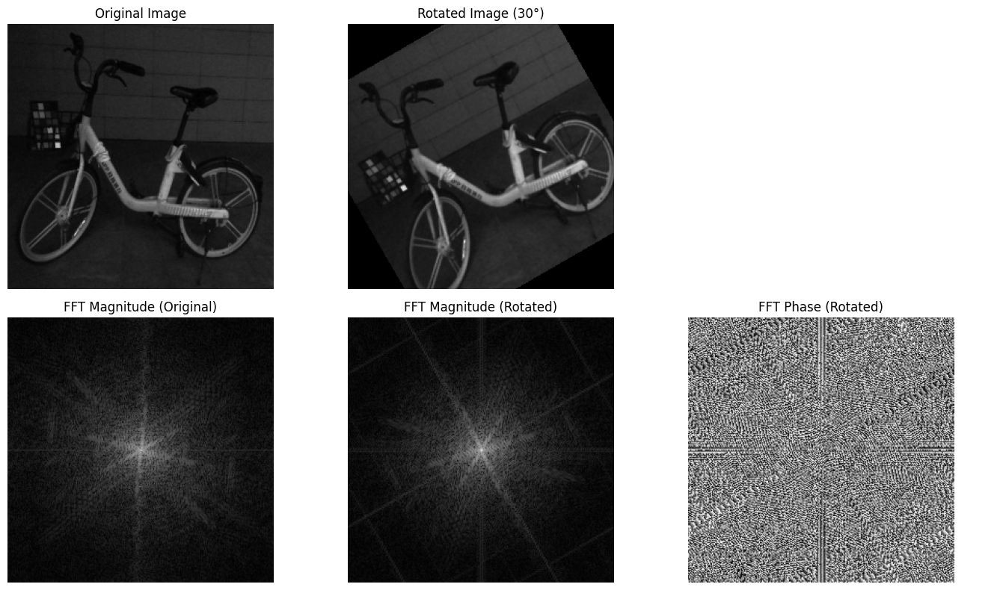

In [115]:
plt.figure(figsize=(10,3))

rotate_and_plot_fft(resize_for_fft(img_bike), 30)

<Figure size 1000x300 with 0 Axes>

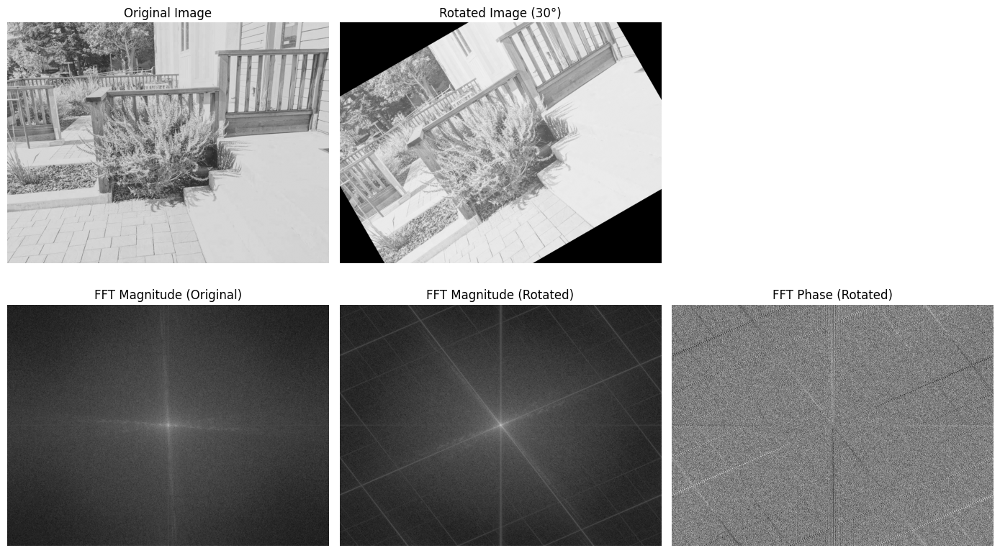

In [116]:
plt.figure(figsize=(10,3))

rotate_and_plot_fft(img_haze, 30)

#### 3. Frequency-Domain High-Pass Filtering

- Implement a **frequency-domain high-pass filter** defined as:  

  $$
  H_{\text{high-pass}}(u,v) = 1 - H_{\text{low-pass}}(u,v)
  $$

- Use low-pass filters:
  - Gaussian  
  - Box blur  

- Apply the high-pass filter to an image.  
- Add the filtered result back to the original image to observe **edge enhancement**.  


In [117]:
kern = gaussian_kernel(7, sigma=1)
# Pad kernel to match image size, centered
pad_kern = np.zeros_like(img, dtype=np.float32)
kh, kw = kern.shape
r, c = img.shape

# # Compute starting indices for centering
start_x = (r - kh) // 2
start_y = (c - kw) // 2

pad_kern[start_x:start_x+kh, start_y:start_y+kw] = kern


# Compute FFTs
# fshift_img, mag_img = compute_fft(img_gauss_smallest)
fshift_kern, mag_kern = compute_fft(pad_kern)

In [120]:
H_low = fshift_kern
H_high = 1 - H_low
# Magnitude spectrum of high-pass filter
mag_high = np.log(1 + np.abs(H_high))


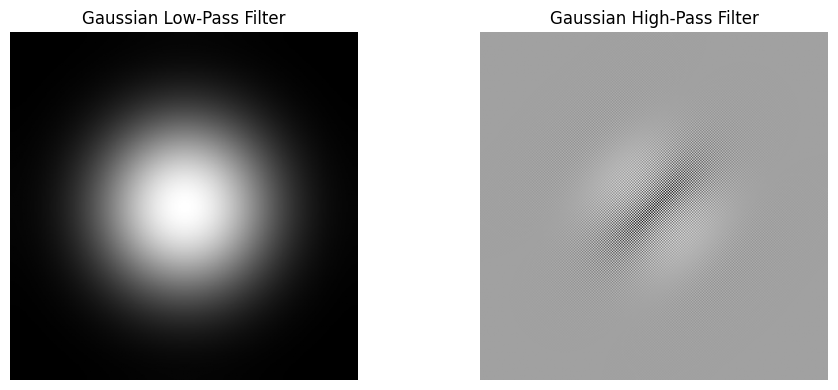

In [121]:
plt.figure(figsize=(10,4))

plt.subplot(1,2,1)
plt.imshow(mag_kern, cmap='gray')
plt.title("Gaussian Low-Pass Filter")
plt.axis('off')

plt.subplot(1,2,2)
plt.imshow(mag_high, cmap='gray')
plt.title("Gaussian High-Pass Filter")
plt.axis('off')

plt.tight_layout()
plt.show()


In [122]:
# Box Filter
N = 7
kern_box= np.ones((N, N)) / (N*N)
# Pad kernel to match image size, centered
pad_kern_box = np.zeros_like(chessboard_img, dtype=np.float32)
kh, kw = kern_box.shape
r, c = chessboard_img.shape

# # Compute starting indices for centering
start_x = (r - kh) // 2
start_y = (c - kw) // 2

pad_kern_box[start_x:start_x+kh, start_y:start_y+kw] = kern_box


# Compute FFTs
# fshift_img, mag_img = compute_fft(img_gauss_smallest)
fshift_kern_box, mag_kern_box = compute_fft(pad_kern)


In [125]:
H_low_box = fshift_kern_box
H_high_box = 1 - H_low_box
# Magnitude spectrum of high-pass filter
mag_high_box = np.log(1 + np.abs(H_high_box))


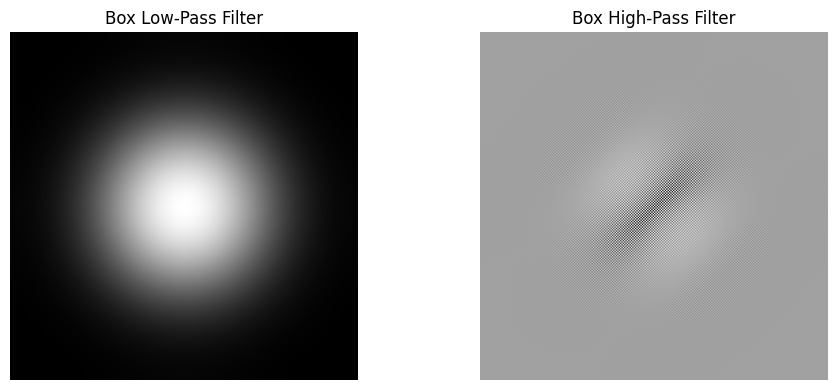

In [126]:
plt.figure(figsize=(10,4))

plt.subplot(1,2,1)
plt.imshow(mag_kern_box, cmap='gray')
plt.title("Box Low-Pass Filter")
plt.axis('off')

plt.subplot(1,2,2)
plt.imshow(mag_high_box, cmap='gray')
plt.title("Box High-Pass Filter")
plt.axis('off')

plt.tight_layout()
plt.show()


In [141]:
# Kernel must be shifted to (0,0) first
kern_shifted = np.fft.ifftshift(H_high)

# Unshifted FFTs
img = resize_for_fft(img_bike)
F_img  = np.fft.fft2(img)
F_kern = np.fft.fft2(kern_shifted)

# Frequency-domain multiplication
F_high = F_img * F_kern
img_high = np.fft.ifft2(F_high)
img_high = np.real(img_high)

mag_mult = np.log(1 + np.abs(np.fft.fftshift(F_high)))


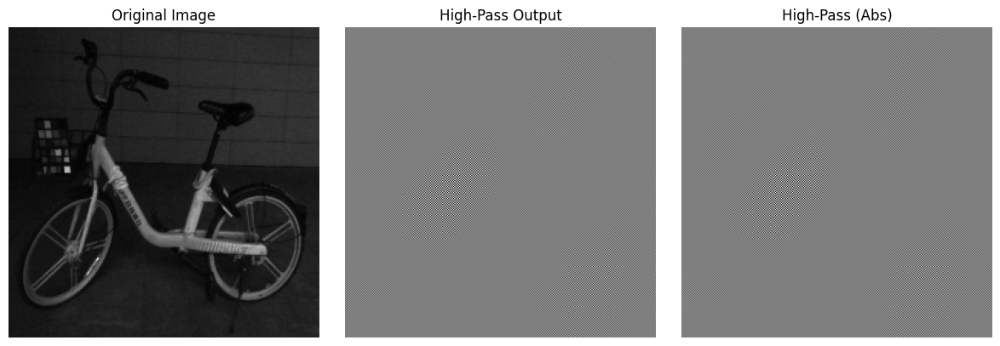

In [142]:
plt.figure(figsize=(12,4))

plt.subplot(1,3,1)
plt.imshow(img, cmap='gray')
plt.title("Original Image")
plt.axis('off')

plt.subplot(1,3,2)
plt.imshow(img_high, cmap='gray')
plt.title("High-Pass Output")
plt.axis('off')

plt.subplot(1,3,3)
plt.imshow(np.abs(img_high), cmap='gray')
plt.title("High-Pass (Abs)")
plt.axis('off')

plt.tight_layout()
plt.show()
